# AirBnb Analysis in Milan
## Marco Tonin - 214050
### Geospatial Analysis and Representation for Data Science - University of Trento

Tasks:

-  choose one of the cities available from the InsideAirbnb
- retrieve data on neighborhoods (city data portal)
- view statistical information on neighborhoods (city data portal)
- identify which are the neighborhoods with the highest prices in AirBnB
- identify which are the districts with the greatest number of tourist activities (city data portal and/or openstreetmap)
- find the location of 3 AirBnB hosts closest to one of the city's museums (on walking distance)  (city data portal and/oropenstreetmap)
- of the three hosts, identify which one has the greatest number of services (supermarkets, pharmacies, restaurants) in an area of 300m  (city data portal and/or openstreetmap)
- analyze and test spatial autocorrelation of price
- represent these analyses on maps (web and not)

These tasks will be performed analysing the city of Milan.

All the data sources are available in the folder *Data*. Here where data sources come from:

Data from *Inside Airbnb* about Milan available here:
http://insideairbnb.com/get-the-data.html

Data about neighbourhoods have been retrieved from the city data portal. In specific, the csv file available here:
https://dati.comune.milano.it/dataset/ds205-sociale-caratteristiche-demografiche-territoriali-quartiere/resource/084457a7-ec4b-4a6b-b463-d8ab53c64fbb

Data about touristic activities have been retrieved from OpenStreetMap. Available here:
https://export.hotosm.org/en/v3/exports/c88878dc-da59-41fd-b1c7-1f7c214b3e4c

## Import libraries

In [1]:
#necessary libraries with version: 
import pandas as pd                                            #1.1.4
import geopandas as gpd                                        #0.8.1
import matplotlib.pyplot as plt                                #3.3.3
import seaborn as sns                                          #0.11.0
import contextily as ctx                                       #1.0.1
import folium                                                  #0.11.0
from branca.element import Figure                              #0.4.1
from folium.plugins import MarkerCluster                       
import pyrosm                                                  #0.5.3
from shapely.geometry import Polygon, Point                    #1.7.1
import osmnx as ox                                             #0.16.1
from shapely.ops import transform                              
import pyproj                                                  #2.6.1.post1

import warnings
warnings.filterwarnings('ignore')

## Import Datasets

In [2]:
#statistical data by neighbourhood in Milan
stats_milano = pd.read_csv('data/datiquartierimilano.csv')

#geojson file with the shape of the neighbourhoods
neighbourhoods = gpd.read_file('data/neighbourhoods.geojson')

#listings file of Airbnb in Milan
airbnb = pd.read_csv('data/listings.csv')

## Data Pre-Processing

### Stats_milano

Data pre-processing step for this csv file consists of:

- select one year (the file has information about years from 2011)
- filter columns (useful columns) to read more easily the df
- modify the column 'Quartiere', to merge the df in the correct way

In [3]:
#select only 2017 information
stats_milano = stats_milano[stats_milano['Anno'] == 2017].reset_index()

#filter columns
col_stats = ['Quartiere',
            'Uomini',
            'Donne',
            'Totale',
            'Stranieri',
            "Scuola dell'infanzia (numero)",
            'Scuola primaria (numero)',
            'Scuola secondaria di primo grado (numero)',
            'Area (metri quadrati)',
            'fermate linee superficie',
            'fermate metro',
            'piste ciclabili (m)']

stats_milano = stats_milano[col_stats]

#uppercase for name of the neighbourhoods (necessary to merge the dfs)
stats_milano['Quartiere'] = stats_milano['Quartiere'].str.upper()

In [4]:
#look at the first rows
stats_milano.head()

,Quartiere,Uomini,Donne,Totale,Stranieri,Scuola dell'infanzia (numero),Scuola primaria (numero),Scuola secondaria di primo grado (numero),Area (metri quadrati),fermate linee superficie,fermate metro,piste ciclabili (m)
0,ADRIANO,8778.0,8169.0,16947.0,3921,4,1,0,"2431560,11",34,0,1360
1,AFFORI,12438.0,12455.0,24893.0,7214,6,3,2,"2070893,65",21,2,1550
2,BAGGIO,14062.0,15599.0,29661.0,5541,7,3,2,"3478599,96",55,0,0
3,BANDE NERE,20202.0,24028.0,44230.0,7050,13,7,6,"2663880,93",73,3,0
4,BARONA,7963.0,9055.0,17018.0,2376,3,3,1,"2006324,59",59,0,1240


### Neighbourhoods

Data pre-processing step for this csv file consists of:

- rename some neighbourhoods, written in a different way from the previous file
- sort the df by alphabetic order
- filter, keeping only the name and the geometry

In [5]:
#some names are written in a different way from the other data source
neighbourhoods = neighbourhoods.replace("CITTA' STUDI",'CITTÀ STUDI')
neighbourhoods = neighbourhoods.replace("NIGUARDA - CA' GRANDA",'NIGUARDA - CÀ GRANDA')
neighbourhoods = neighbourhoods.replace('PARCO BOSCO IN CITT\x85','PARCO BOSCO IN CITTÀ')
neighbourhoods = neighbourhoods.replace("PARCO MONLUE' - PONTE LAMBRO",'PARCO MONLUÉ - PONTE LAMBRO')

#sort the df by alphabetic order
neighbourhoods = neighbourhoods.sort_values('neighbourhood').reset_index()

#filter columns
neighbourhoods = neighbourhoods[['neighbourhood', 'geometry']]

In [6]:
#look at the first rows
neighbourhoods.head()

,neighbourhood,geometry
0,ADRIANO,"MULTIPOLYGON (((9.25520 45.51992, 9.25529 45.5..."
1,AFFORI,"MULTIPOLYGON (((9.18204 45.50732, 9.18378 45.5..."
2,BAGGIO,"MULTIPOLYGON (((9.08347 45.45145, 9.08303 45.4..."
3,BANDE NERE,"MULTIPOLYGON (((9.12906 45.46064, 9.12883 45.4..."
4,BARONA,"MULTIPOLYGON (((9.16227 45.42787, 9.16112 45.4..."


In [7]:
neighbourhoods.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

### AirBnb

Data pre-processing step for this csv file consists of:

- transform it into a Geopandas Dataframe
- rename the neighbourhoods as above
- filter the columns, to improve readability

In [8]:
#transform the pd dataframe to a Geopandas DataFrame
geo_airbnb = gpd.GeoDataFrame(
    airbnb,
    crs='EPSG:4326',                            
    geometry=gpd.points_from_xy(airbnb.longitude, airbnb.latitude))

#as above, modify neighbourhoods' name
geo_airbnb = geo_airbnb.replace("CITTA' STUDI",'CITTÀ STUDI')
geo_airbnb = geo_airbnb.replace("NIGUARDA - CA' GRANDA",'NIGUARDA - CÀ GRANDA')
geo_airbnb = geo_airbnb.replace('PARCO BOSCO IN CITT\x85','PARCO BOSCO IN CITTÀ')
geo_airbnb = geo_airbnb.replace("PARCO MONLUE' - PONTE LAMBRO",'PARCO MONLUÉ - PONTE LAMBRO')

#filter columns
col_airbnb = ['name',
             'host_name',
             'neighbourhood',
             'latitude',
             'longitude',
             'room_type',
             'price',
             'geometry']

geo_airbnb = geo_airbnb[col_airbnb]

In [9]:
geo_airbnb.head()

,name,host_name,neighbourhood,latitude,longitude,room_type,price,geometry
0,The Studio Milan,Francesca,TIBALDI,45.44195,9.17797,Private room,100,POINT (9.17797 45.44195)
1,Best Opportunity MPX-EXPO-CENTER,Simone,BOVISA,45.50480,9.16199,Entire home/apt,150,POINT (9.16199 45.50480)
2,""" Characteristic Milanese flat""",Jeremy,NAVIGLI,45.44991,9.17597,Entire home/apt,150,POINT (9.17597 45.44991)
3,Nico & Cynthia's Easy Yellow Suite,Nico&Cinzia,VIALE MONZA,45.51988,9.22310,Entire home/apt,75,POINT (9.22310 45.51988)
4,Nico&Cinzia's Red Easy Suite!,Nico&Cinzia,VIALE MONZA,45.51942,9.22615,Entire home/apt,71,POINT (9.22615 45.51942)


In [10]:
geo_airbnb.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

## Data Merging

In this step, dataframes are merged by the name of the neighbourhoods.

In [11]:
#merging the pd df 'stats_milano' and the gpd 'neighbourhoods'
geo_stats_milano = stats_milano.merge(neighbourhoods, left_on='Quartiere', right_on='neighbourhood')

#transfrom it into a Geopandas DataFrame
geo_stats_milano = gpd.GeoDataFrame(
    geo_stats_milano,
    crs='EPSG:4326',
    geometry=geo_stats_milano.geometry)

#look at the first rows
geo_stats_milano.head()

,Quartiere,Uomini,Donne,Totale,Stranieri,Scuola dell'infanzia (numero),Scuola primaria (numero),Scuola secondaria di primo grado (numero),Area (metri quadrati),fermate linee superficie,fermate metro,piste ciclabili (m),neighbourhood,geometry
0,ADRIANO,8778.0,8169.0,16947.0,3921,4,1,0,"2431560,11",34,0,1360,ADRIANO,"MULTIPOLYGON (((9.25520 45.51992, 9.25529 45.5..."
1,AFFORI,12438.0,12455.0,24893.0,7214,6,3,2,"2070893,65",21,2,1550,AFFORI,"MULTIPOLYGON (((9.18204 45.50732, 9.18378 45.5..."
2,BAGGIO,14062.0,15599.0,29661.0,5541,7,3,2,"3478599,96",55,0,0,BAGGIO,"MULTIPOLYGON (((9.08347 45.45145, 9.08303 45.4..."
3,BANDE NERE,20202.0,24028.0,44230.0,7050,13,7,6,"2663880,93",73,3,0,BANDE NERE,"MULTIPOLYGON (((9.12906 45.46064, 9.12883 45.4..."
4,BARONA,7963.0,9055.0,17018.0,2376,3,3,1,"2006324,59",59,0,1240,BARONA,"MULTIPOLYGON (((9.16227 45.42787, 9.16112 45.4..."


In [12]:
#check the crs
geo_stats_milano.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

## Statistical information about neighbourhoods

### Population 

- check most populated neighbourhoods
- web map: choropleth map with the distribution of the population
- static map

In [13]:
#check the most populated neighbourhoods
population = geo_stats_milano.sort_values('Totale', ascending=False)
population[['Quartiere', 'Totale']].head(10)

,Quartiere,Totale
10,BUENOS AIRES - VENEZIA,61891.0
37,LORETO,44863.0
3,BANDE NERE,44230.0
85,VILLAPIZZONE,41216.0
46,PADOVA,37081.0
44,NIGUARDA - CÀ GRANDA,36795.0
15,CITTÀ STUDI,36232.0
35,LODI - CORVETTO,36085.0
25,GALLARATESE,32494.0
87,XXII MARZO,31667.0


The most populated neighbourhood is *Buenos Aires - Venezia*, with 61891 inhabitants.

In [14]:
#create the map, with a focus on Milan
fig1 = Figure(width=550,height=350)                              #width and height of the map
m1 = folium.Map(location = [45.46427, 9.18951], zoom_start=11)   #create map

#generate choropleth map
folium.Choropleth(                                               
    geo_data = neighbourhoods.to_json(),
    data = geo_stats_milano,
    columns=['Quartiere', 'Totale'],
    key_on='feature.properties.neighbourhood',
    fill_color='OrRd', 
    fill_opacity=0.7, 
    line_opacity=1,
    legend_name='Population by Neighbourhood',
    smooth_factor=0).add_to(m1)

#add labels with information
folium.features.GeoJson(geo_stats_milano,
                        name='Labels',
                        style_function=lambda x: {'color':'transparent','fillColor':'transparent','weight':0},
                        tooltip=folium.features.GeoJsonTooltip(fields=['Quartiere', 'Totale'],
                                                                labels=True,
                                                                sticky=False
                                                                            )
                       ).add_to(m1)

fig1.add_child(m1)
m1

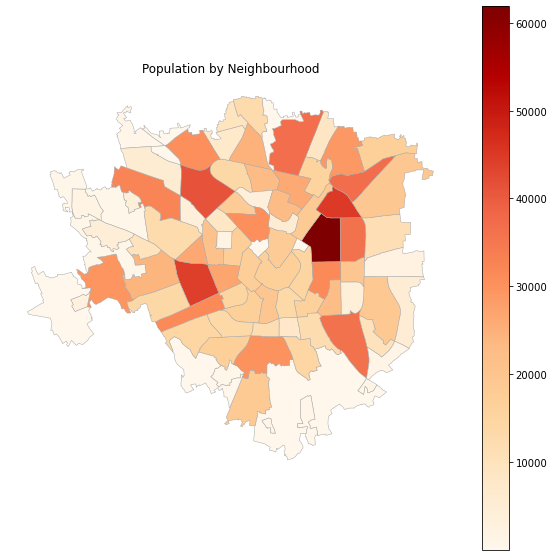

In [15]:
#same data but with a static map
ax1 = geo_stats_milano.plot(column='Totale',
                  cmap="OrRd", edgecolor = "darkgrey", 
                  linewidth = 0.5,legend=True,figsize=(10,10))

ax1.set_axis_off()
ax1.set_title('Population by Neighbourhood')
plt.show()

### Population Density

It is important to look to the population density:

- compute population density
- look at the more populated neighbourhoods, by population density
- web map
- static map

In [16]:
#check the neighbourhoods with the higher population density

#compute the population density(ab per km^2)
geo_stats_milano['Area (metri quadrati)'] = pd.to_numeric(geo_stats_milano['Area (metri quadrati)'].str.replace(",","."))
geo_stats_milano['Population_Density'] = round(geo_stats_milano['Totale'] / (geo_stats_milano['Area (metri quadrati)']/1000000),2)

density = geo_stats_milano.sort_values('Population_Density', ascending=False)
density[['Quartiere', 'Population_Density']].head(10)

,Quartiere,Population_Density
73,SELINUNTE,26982.75
83,VIALE MONZA,25729.38
37,LORETO,25671.71
10,BUENOS AIRES - VENEZIA,21508.29
86,WASHINGTON,20554.16
87,XXII MARZO,19338.63
82,UMBRIA - MOLISE,19059.09
17,CORSICA,18143.40
46,PADOVA,17983.50
33,ISOLA,17306.56


The neighbourhood with the highest population density is *Selinunte*.

In [17]:
#create the map, with a focus on Milan
fig2 = Figure(width=550,height=350)                              #width and height of the map
m2 = folium.Map(location = [45.46427, 9.18951], zoom_start=11)   #create map

#generate choropleth map
folium.Choropleth(
    geo_data = neighbourhoods.to_json(),
    data = geo_stats_milano,
    columns=['Quartiere', 'Population_Density'],
    key_on='feature.properties.neighbourhood',
    fill_color='OrRd', 
    fill_opacity=0.7, 
    line_opacity=1,
    legend_name='Population density by Neighbourhood',
    smooth_factor=0).add_to(m2)

#add layer with features
folium.features.GeoJson(geo_stats_milano,
                        name='Labels',
                        style_function=lambda x: {'color':'transparent','fillColor':'transparent','weight':0},
                        tooltip=folium.features.GeoJsonTooltip(fields=['Quartiere', 'Population_Density'],
                                                                labels=True,
                                                                sticky=False
                                                                            )
                       ).add_to(m2)


fig2.add_child(m2)
m2

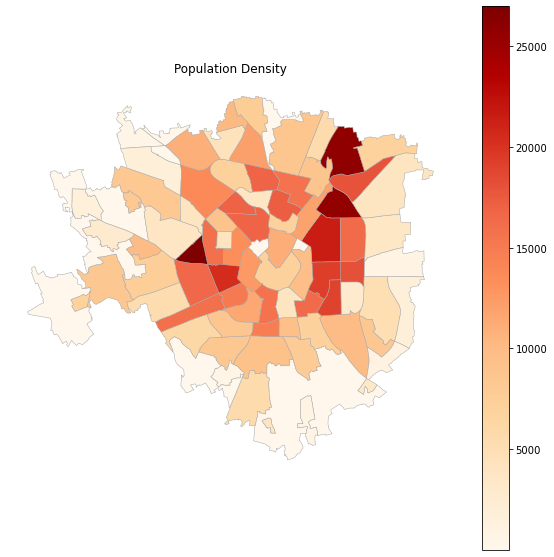

In [18]:
#same data but with a static map
ax2 = geo_stats_milano.plot(column='Population_Density',
                  cmap="OrRd", edgecolor = "darkgrey", 
                  linewidth = 0.5,legend=True,figsize=(10,10))

ax2.set_axis_off()
ax2.set_title('Population Density')
plt.show()

## AirBnb Exploratory Data Analysis

In the exploratory data analysis about the Airbnb dataframe the steps are:

- build a static map with the Airbnb in Milan
- build a web map, with the information: name, host and neighbourhood

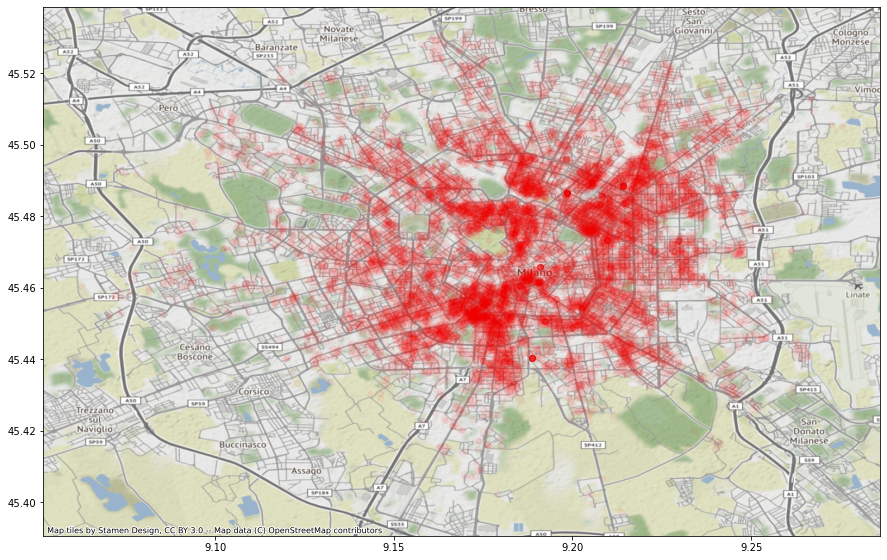

In [19]:
#plot AirBnb in a static map
ax3 = geo_airbnb.plot(alpha=0.05, color="red", figsize=(15, 15))
ctx.add_basemap(ax3, crs=geo_airbnb.crs.to_string())

In [20]:
#function to get the markers for the map 
def getMarker(lat, lon, message, tip, inconstyle):
    marker = folium.Marker(location=[lat,lon],
                         popup=message,
                         tooltip=tip,
                         icon=inconstyle)
    return marker

#create folium map
fig3 = Figure(width=550,height=350)
m3=folium.Map(location=[45.46427, 9.18951], zoom_start=11)

#create cluster for the markers
marker_cluster = MarkerCluster().add_to(m3)

#loop to create the markers for each AirBnb
for index, row in geo_airbnb.iterrows():
    icon=folium.Icon(color='purple',prefix='fa',icon='arrow-circle-down')
    message = '<strong>'+ str(row['name']) + "</strong><br/>" + row['host_name']      #marker has the name, the host_name and the neighbourhood 
    tip = message + '<br/>' + row['neighbourhood']
    marker = getMarker(row['latitude'],row['longitude'],message, tip, icon)
    
    #add to marker cluster 
    marker.add_to(marker_cluster)
    
fig3.add_child(m3)
m3

## Neighbourhoods with the highest prices in AirBnb in Milan

To obtain the neighbourhoods with the highest prices in AirBnb in Milan the steps are:

- compute the average prices for each neighbourhood, rounded to the second decimal
- *CASCINA TRIULZA - EXPO* does not have Airbnbs -> therefore, to merge the df, it is necessary to add it
- merge the pd.series to the df
- sort the df by the average price
- plot it in a web map

In [21]:
#compute the average price of the Airbnbs for each neighbourhood, rounded to the second decimal
prices = round(geo_airbnb.groupby(by=['neighbourhood']).mean().price, 2)  

#add 'CASCINA TRIULZA - EXPO', which does not have Airbnbs, to the pd series to merge the dfs
prices = prices.append(pd.Series(0, index=['CASCINA TRIULZA - EXPO'])).sort_index().reset_index()

#merge the prices to the file 'geo_stats_milano' and rename the column
geo_stats_milano = pd.merge(geo_stats_milano, prices, how='left', left_on='Quartiere', right_on='index')
geo_stats_milano = geo_stats_milano.drop(columns=['neighbourhood', 'index'])
geo_stats_milano.rename(columns={0: 'average_price'}, inplace=True)

#look at the first rows
geo_stats_milano.head()

,Quartiere,Uomini,Donne,Totale,Stranieri,Scuola dell'infanzia (numero),Scuola primaria (numero),Scuola secondaria di primo grado (numero),Area (metri quadrati),fermate linee superficie,fermate metro,piste ciclabili (m),geometry,Population_Density,average_price
0,ADRIANO,8778.0,8169.0,16947.0,3921,4,1,0,2431560.11,34,0,1360,"MULTIPOLYGON (((9.25520 45.51992, 9.25529 45.5...",6969.60,91.08
1,AFFORI,12438.0,12455.0,24893.0,7214,6,3,2,2070893.65,21,2,1550,"MULTIPOLYGON (((9.18204 45.50732, 9.18378 45.5...",12020.41,81.98
2,BAGGIO,14062.0,15599.0,29661.0,5541,7,3,2,3478599.96,55,0,0,"MULTIPOLYGON (((9.08347 45.45145, 9.08303 45.4...",8526.71,54.09
3,BANDE NERE,20202.0,24028.0,44230.0,7050,13,7,6,2663880.93,73,3,0,"MULTIPOLYGON (((9.12906 45.46064, 9.12883 45.4...",16603.59,82.16
4,BARONA,7963.0,9055.0,17018.0,2376,3,3,1,2006324.59,59,0,1240,"MULTIPOLYGON (((9.16227 45.42787, 9.16112 45.4...",8482.18,61.40


In [22]:
#look at the neighbourhoods with the highest average price
top_prices = geo_stats_milano.sort_values('average_price', ascending=False)
top_prices[['Quartiere', 'average_price']].head(10)

,Quartiere,average_price
47,PAGANO,224.88
39,MAGENTA - S. VITTORE,206.35
8,BRERA,202.61
29,GIARDINI PORTA VENEZIA,170.52
62,QUINTO ROMANO,168.33
70,SACCO,166.57
73,SELINUNTE,164.55
32,GUASTALLA,147.45
20,DUOMO,141.58
87,XXII MARZO,134.89


The neighbourhood with the highest price of Airbnb is *Pagano*.

In [23]:
#plot it in a web map
fig4 = Figure(width=550,height=350)
m4 = folium.Map(location=[45.46427, 9.18951], zoom_start=11)


folium.Choropleth(
    geo_data=neighbourhoods.to_json(),
    data = geo_stats_milano,
    columns=['Quartiere', 'average_price'],
    key_on='feature.properties.neighbourhood',
    fill_color='OrRd', 
    fill_opacity=0.7, 
    line_opacity=1,
    legend_name='Average price of Airbnb by Neighbourhood',
    smooth_factor=0).add_to(m4)

folium.features.GeoJson(geo_stats_milano,
                        name='Labels',
                        style_function=lambda x: {'color':'transparent','fillColor':'transparent','weight':0},
                        tooltip=folium.features.GeoJsonTooltip(fields=['Quartiere', 'average_price'],
                                                                labels=True,
                                                                sticky=False
                                                                            )
                       ).add_to(m4)

fig4.add_child(m4)
m4

## Districts with the greatest number of tourist activities

Here, the steps are:

- retrieve data from OpenStreetMap (create a geometry of the city, create a bounnding box, import it to the website export.hotosm.org, download the file in .osm.pbf)
- filter the points of interest (also those outside of Milan)
- compute the centroids to map them
- create a web map with the tourist places
- perform a spatial join to check which neighbourhood has the highest number of tourist activities

### Retrieve data from OpenStreetMap

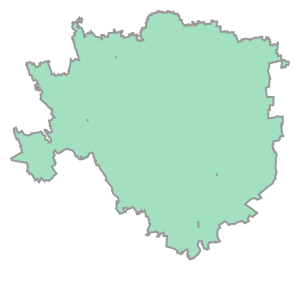

In [24]:
#add a common column to create a single geometry with dissolve
geo_stats_milano['Città'] = 'Milano'

#use dissolve and look at the geometry in a different coordinate reference system (UTM 32 N)
milano = geo_stats_milano.to_crs(epsg=4326).dissolve(by='Città')
milano.to_crs(epsg=32632).geometry[0]

In [25]:
#create the list of the coordinates
bbox = list(milano.to_crs(epsg=4326).geometry.bounds.values[0])

#assign to variables
minx = bbox[0]
miny = bbox[1]
maxx = bbox[2]
maxy = bbox[3]

#create Polygon
polygon = Polygon([[minx, miny], [maxx, miny], [maxx, maxy], [minx, maxy]])

#create a variable to create the Geopandas DataFrame
data = {'description': ['bbox_Milano'], 'geometry': [polygon]}

#create the bbox gpd and give a look
bbox_Milano = gpd.GeoDataFrame(data, crs="epsg:4326")
bbox_Milano

,description,geometry
0,bbox_Milano,"POLYGON ((9.04059 45.38674, 9.27805 45.38674, ..."


In [26]:
#create the bbox file in geojson to retrieve data from OSM
bbox_Milano.to_file("bbox_Milano.geojson",driver="GeoJSON")

In this website, there is the files created with the bbox file. From export hotosm tool I've created the file in .osm.pbf to retrieve data inside the bbox created.
https://export.hotosm.org/en/v3/exports/c88878dc-da59-41fd-b1c7-1f7c214b3e4c

In [27]:
#name of the path in the folder
path_pbf_file = "data/bbox_Milano.osm.pbf"

#open it with pyrosm
osm = pyrosm.OSM(path_pbf_file,bounding_box=bbox)

#look at the information available (our focus is on tourism)
osm.conf.tags.available

['aerialway',
 'aeroway',
 'amenity',
 'boundary',
 'building',
 'craft',
 'emergency',
 'geological',
 'highway',
 'historic',
 'landuse',
 'leisure',
 'natural',
 'office',
 'power',
 'public_transport',
 'railway',
 'route',
 'place',
 'shop',
 'tourism',
 'waterway']

In [28]:
#select tourism points of interest (NB: these are the pois inside the bbox, so it could be they are not in Milan)
tourism_bbox = osm.get_pois(custom_filter={'tourism' : True})
tourism_bbox.head()

,timestamp,id,lon,version,tags,lat,changeset,addr:city,addr:country,addr:housenumber,...,website,information,tourism,geometry,osm_type,addr:housename,ref,attraction,guest_house,museum
0,127,1875027111,9.205918,127,"{""contact:website"":""http://www.visitamilano.it...",45.486038,127.0,None,None,None,...,None,office,information,POINT (9.20592 45.48604),node,NaN,NaN,NaN,NaN,NaN
1,-50,2529645009,9.179755,-50,"{""comment:it"":""Fa parte dei Musei del Castello...",45.470982,-50.0,None,None,None,...,None,None,museum,POINT (9.17976 45.47098),node,NaN,NaN,NaN,NaN,NaN
2,-8,2973140267,9.188036,-8,"{""artwork_type"":""statue"",""material"":""marble""}",45.464977,-8.0,None,None,None,...,None,None,artwork,POINT (9.18804 45.46498),node,NaN,NaN,NaN,NaN,NaN
3,0,4269864741,9.070186,0,"{""addr:province"":""Milano""}",45.418026,0.0,Trezzano sul Naviglio,IT,12,...,None,None,guest_house,POINT (9.07019 45.41803),node,NaN,NaN,NaN,NaN,NaN
4,-106,4756745053,9.170817,-106,"{""stars"":""3""}",45.453892,-106.0,Milano,None,15,...,https://www.hotelminervamilan.com/,None,hotel,POINT (9.17082 45.45389),node,NaN,NaN,NaN,NaN,NaN


In [29]:
#look at the number of pois
tourism_bbox.shape

(165, 27)

In [30]:
#filter with the within spatial operations the tourism pois, selecting those within the geometry of Milan 
#created above with the dissolve function)
tourism_milan = tourism_bbox[tourism_bbox.within(milano.geometry[0])]
tourism_milan.shape

(145, 27)

The spatial operation has removed 20 pois, which were outside the geometry of Milan.

### Data Processing 

In [31]:
tourism_milan.columns

Index(['timestamp', 'id', 'lon', 'version', 'tags', 'lat', 'changeset',
       'addr:city', 'addr:country', 'addr:housenumber', 'addr:postcode',
       'addr:street', 'email', 'name', 'opening_hours', 'operator', 'phone',
       'website', 'information', 'tourism', 'geometry', 'osm_type',
       'addr:housename', 'ref', 'attraction', 'guest_house', 'museum'],
      dtype='object')

In [32]:
#create a column with the centroids, and then create columns about latitude and longitude, and check
tourism_milan['centroid'] = tourism_milan.geometry.centroid.to_crs(epsg=4326)

tourism_milan['longitude'] = tourism_milan.centroid.x
tourism_milan['latitude'] = tourism_milan.centroid.y

#filter columns
tourism_milan = tourism_milan[['name', 'tourism', 'geometry', 'osm_type', 'centroid', 'longitude', 'latitude']]

tourism_milan.head()

,name,tourism,geometry,osm_type,centroid,longitude,latitude
0,Informazione e Accoglienza Turistica Provincia...,information,POINT (9.20592 45.48604),node,POINT (9.20592 45.48604),9.205918,45.486038
1,Museo Egizio,museum,POINT (9.17976 45.47098),node,POINT (9.17976 45.47098),9.179755,45.470982
2,Sancti Ambrosii,artwork,POINT (9.18804 45.46498),node,POINT (9.18804 45.46498),9.188036,45.464977
4,Hotel Minerva,hotel,POINT (9.17082 45.45389),node,POINT (9.17082 45.45389),9.170817,45.453892
5,Suitime Milano,guest_house,POINT (9.16598 45.46326),node,POINT (9.16598 45.46326),9.165979,45.463264


In [33]:
# Create a web map with the points (centroid) about tourism activities
fig5 = Figure(width=550,height=350)
m5 = folium.Map(location=[45.46427, 9.18951], zoom_start=12)

def getMarker2(lat,lon, message,tip):
    marker = folium.Marker(location=[lat,lon],
                         popup=message,
                         tooltip=tip)
    return marker

for index, row in tourism_milan.iterrows():
    marker = getMarker2(row['latitude'],row['longitude'],row['tourism'],row['name'])
    marker.add_to(m5)
    
fig5.add_child(m5)
m5

### Identify the neighbourhoods with the highest number of tourist activities

In [34]:
#spatial join of tourism_milan and neighbourhoods, to see where the tourist activities are
tourism_and_neigh = gpd.sjoin(neighbourhoods, tourism_milan,
                    how='inner', op='contains', lsuffix='neigh', rsuffix='test')

tourism_and_neigh.head()

,neighbourhood,geometry,index_test,name,tourism,osm_type,centroid,longitude,latitude
1,AFFORI,"MULTIPOLYGON (((9.18204 45.50732, 9.18378 45.5...",46,La Residenza,hotel,way,POINT (9.17875 45.51236),9.178747,45.512356
3,BANDE NERE,"MULTIPOLYGON (((9.12906 45.46064, 9.12883 45.4...",124,Hotel Rubens,hotel,way,POINT (9.14302 45.46711),9.143020,45.467109
5,BICOCCA,"MULTIPOLYGON (((9.21626 45.52931, 9.21643 45.5...",77,Pirelli HangarBicocca,attraction,way,POINT (9.21999 45.52201),9.219994,45.522010
7,BOVISASCA,"MULTIPOLYGON (((9.16763 45.52272, 9.16803 45.5...",62,OstellOlinda,hostel,way,POINT (9.16342 45.52255),9.163425,45.522545
8,BRERA,"MULTIPOLYGON (((9.19768 45.47654, 9.19701 45.4...",160,Teatro alla Scala,attraction,relation,POINT (9.18911 45.46757),9.189106,45.467569


In [35]:
#group by neighbourhood and check which neighbourhood has more tourist activities
total_tourism_and_neigh = tourism_and_neigh.groupby(['neighbourhood']).size().to_frame('number_tourist_activities').reset_index().sort_values(['number_tourist_activities', 'neighbourhood'], ascending=False)

total_tourism_and_neigh.head(10)

,neighbourhood,number_tourist_activities
12,DUOMO,32
4,BRERA,9
18,GUASTALLA,7
37,SARPI,6
17,GIARDINI PORTA VENEZIA,6
15,GARIBALDI REPUBBLICA,6
8,CENTRALE,6
31,PARCO SEMPIONE,4
25,NAVIGLI,4
23,MAGENTA - S. VITTORE,4


*Duomo* is the neighbourhood with the highest number of tourist activities.

## Find the location of 3 Airbnb hosts closest to a museum (on walking distance) 

To find the location of the 3 Airbnb hosts closest to a museum:

- decide which museum take into consideration
- create the street network
- find the nearest nodes of the museum and of the airbnbs
- compute the travel time from the nearest node of the museum and the nearest nodes of each Airbnb
- look at the closest Airbnb hosts

In [36]:
#filter to obtain only museums and look at all the musesums in Milan, available in OSM
museums = tourism_and_neigh[tourism_and_neigh['tourism'] == 'museum']
museums

,neighbourhood,geometry,index_test,name,tourism,osm_type,centroid,longitude,latitude
8,BRERA,"MULTIPOLYGON (((9.19768 45.47654, 9.19701 45.4...",156,Museo d'arte e scienza,museum,relation,POINT (9.18240 45.47043),9.182395,45.470426
17,CORSICA,"MULTIPOLYGON (((9.23790 45.46813, 9.23789 45.4...",108,WOW Spazio Fumetto,museum,way,POINT (9.22435 45.46323),9.224354,45.463232
20,DUOMO,"MULTIPOLYGON (((9.18125 45.46903, 9.18211 45.4...",145,Palazzo Reale,museum,relation,POINT (9.19129 45.46293),9.191293,45.462928
20,DUOMO,"MULTIPOLYGON (((9.18125 45.46903, 9.18211 45.4...",87,Grande Museo del Duomo,museum,way,POINT (9.19178 45.46351),9.191781,45.463511
20,DUOMO,"MULTIPOLYGON (((9.18125 45.46903, 9.18211 45.4...",155,Museo Civico Archeologico,museum,relation,POINT (9.17873 45.46547),9.178734,45.465467
20,DUOMO,"MULTIPOLYGON (((9.18125 45.46903, 9.18211 45.4...",162,Casa di Alessandro Manzoni,museum,relation,POINT (9.19194 45.46781),9.191937,45.467815
20,DUOMO,"MULTIPOLYGON (((9.18125 45.46903, 9.18211 45.4...",1,Museo Egizio,museum,node,POINT (9.17976 45.47098),9.179755,45.470982
29,GIARDINI PORTA VENEZIA,"MULTIPOLYGON (((9.20305 45.47555, 9.20407 45.4...",151,Museo Civico di Storia Naturale,museum,relation,POINT (9.20220 45.47286),9.202196,45.472860
29,GIARDINI PORTA VENEZIA,"MULTIPOLYGON (((9.20305 45.47555, 9.20407 45.4...",89,Paleolab,museum,way,POINT (9.19805 45.47523),9.198049,45.475227
32,GUASTALLA,"MULTIPOLYGON (((9.20658 45.47194, 9.20658 45.4...",58,Villa Necchi Campiglio,museum,way,POINT (9.20182 45.46828),9.201817,45.468279


In [37]:
#Let's check the 3 hosts closest to the Museo Del Design 1880-1980
museo = museums[museums['name'] == 'Museo Del Design 1880-1980']
museo

,neighbourhood,geometry,index_test,name,tourism,osm_type,centroid,longitude,latitude
43,NAVIGLI,"MULTIPOLYGON (((9.17134 45.45586, 9.17173 45.4...",96,Museo Del Design 1880-1980,museum,way,POINT (9.17403 45.44719),9.174025,45.447193


### Street Network Analysis

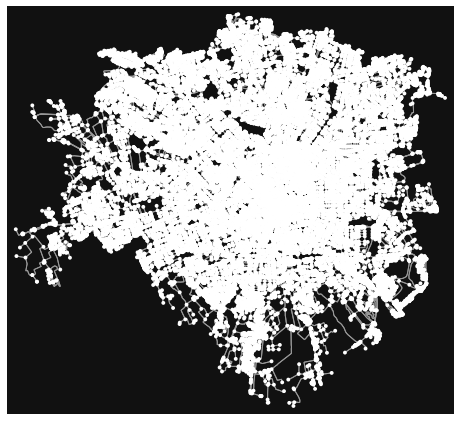

In [38]:
#create the walking route map in Milan to compute the walking distance from the museum to the airbnbs
G = ox.graph_from_place("Milano, Italy", network_type='walk')
fig, ax = ox.plot_graph(G)

In [39]:
#find the nearest node to the Casa di Alessandro Manzoni
point_museo = (museo.latitude.iloc[0], museo.longitude.iloc[0])
point_nearest_museum = ox.get_nearest_node(G, point_museo)
point_nearest_museum

4077180093

Since there are more than 18000 Airbnbs, computation is very slow. 

To overcome this problem, I will filter only Airbnbs in the neighbourhood of Museo Del Design 1880-1980.

In [40]:
geo_airbnb_navigli = geo_airbnb[geo_airbnb['neighbourhood'] == 'NAVIGLI']
print(geo_airbnb_navigli.shape)
geo_airbnb_navigli.head()

(867, 8)


,name,host_name,neighbourhood,latitude,longitude,room_type,price,geometry
2,""" Characteristic Milanese flat""",Jeremy,NAVIGLI,45.44991,9.17597,Entire home/apt,150,POINT (9.17597 45.44991)
30,Beautiful original loft with garden,Laura,NAVIGLI,45.44678,9.16347,Entire home/apt,150,POINT (9.16347 45.44678)
31,Nice quiet room in Navigli district,Elena,NAVIGLI,45.44716,9.17269,Private room,30,POINT (9.17269 45.44716)
50,Milan Navigli 1 bedroom flat quaint,Max,NAVIGLI,45.45180,9.16995,Entire home/apt,98,POINT (9.16995 45.45180)
56,matrimoni red room on Canals center,Bruna,NAVIGLI,45.44657,9.16734,Private room,50,POINT (9.16734 45.44657)


In [41]:
#find the nearest node to each of the Airbnbs
geo_airbnb_navigli['nearest_node'] = geo_airbnb_navigli.geometry.representative_point().apply(lambda point: ox.get_nearest_node(G, (point.y,point.x)))
geo_airbnb_navigli.head()

,name,host_name,neighbourhood,latitude,longitude,room_type,price,geometry,nearest_node
2,""" Characteristic Milanese flat""",Jeremy,NAVIGLI,45.44991,9.17597,Entire home/apt,150,POINT (9.17597 45.44991),4366230500
30,Beautiful original loft with garden,Laura,NAVIGLI,45.44678,9.16347,Entire home/apt,150,POINT (9.16347 45.44678),31107203
31,Nice quiet room in Navigli district,Elena,NAVIGLI,45.44716,9.17269,Private room,30,POINT (9.17269 45.44716),3939296049
50,Milan Navigli 1 bedroom flat quaint,Max,NAVIGLI,45.45180,9.16995,Entire home/apt,98,POINT (9.16995 45.45180),1495158649
56,matrimoni red room on Canals center,Bruna,NAVIGLI,45.44657,9.16734,Private room,50,POINT (9.16734 45.44657),3371559603


In [42]:
hwy_walking_speeds = {
    'motorway ': 0.5,
    'trunk': 0.5,
    'primary': 0.5,
    'secondary': 0.5,
    'tertiary': 0.5,
    'unclassified': 3.5,
    'residential': 3.5,
    'service': 3.5,
    'crossing': 3.5,
    'pedestrian': 3.5,
    'living_street':3.5,
    'steps':3.5,
    'footway': 3.5,
    'track':3.5}
G = ox.add_edge_speeds(G,hwy_speeds=hwy_walking_speeds)
G = ox.add_edge_travel_times(G)

In [43]:
geo_airbnb_navigli['route_from_museum'] = geo_airbnb_navigli.nearest_node.apply(lambda to_point: ox.shortest_path(G, point_nearest_museum, to_point))
geo_airbnb_navigli.head()

,name,host_name,neighbourhood,latitude,longitude,room_type,price,geometry,nearest_node,route_from_museum
2,""" Characteristic Milanese flat""",Jeremy,NAVIGLI,45.44991,9.17597,Entire home/apt,150,POINT (9.17597 45.44991),4366230500,"[4077180093, 4077180102, 29137455, 29137458, 6..."
30,Beautiful original loft with garden,Laura,NAVIGLI,45.44678,9.16347,Entire home/apt,150,POINT (9.16347 45.44678),31107203,"[4077180093, 4077180102, 29137456, 29137457, 4..."
31,Nice quiet room in Navigli district,Elena,NAVIGLI,45.44716,9.17269,Private room,30,POINT (9.17269 45.44716),3939296049,"[4077180093, 4077180102, 29137456, 29137457, 4..."
50,Milan Navigli 1 bedroom flat quaint,Max,NAVIGLI,45.45180,9.16995,Entire home/apt,98,POINT (9.16995 45.45180),1495158649,"[4077180093, 4077180102, 29137455, 29137458, 2..."
56,matrimoni red room on Canals center,Bruna,NAVIGLI,45.44657,9.16734,Private room,50,POINT (9.16734 45.44657),3371559603,"[4077180093, 4077180102, 29137456, 29137457, 4..."


In [44]:
def travel_time_museum(inG, route):
    edge_times = ox.utils_graph.get_route_edge_attributes(inG, route, 'travel_time')
    return (sum(edge_times))

geo_airbnb_navigli['travel_time'] = geo_airbnb_navigli.route_from_museum.apply(lambda route: travel_time_museum(G,route))
geo_airbnb_navigli.head()

,name,host_name,neighbourhood,latitude,longitude,room_type,price,geometry,nearest_node,route_from_museum,travel_time
2,""" Characteristic Milanese flat""",Jeremy,NAVIGLI,45.44991,9.17597,Entire home/apt,150,POINT (9.17597 45.44991),4366230500,"[4077180093, 4077180102, 29137455, 29137458, 6...",399.8
30,Beautiful original loft with garden,Laura,NAVIGLI,45.44678,9.16347,Entire home/apt,150,POINT (9.16347 45.44678),31107203,"[4077180093, 4077180102, 29137456, 29137457, 4...",1400.6
31,Nice quiet room in Navigli district,Elena,NAVIGLI,45.44716,9.17269,Private room,30,POINT (9.17269 45.44716),3939296049,"[4077180093, 4077180102, 29137456, 29137457, 4...",390.1
50,Milan Navigli 1 bedroom flat quaint,Max,NAVIGLI,45.45180,9.16995,Entire home/apt,98,POINT (9.16995 45.45180),1495158649,"[4077180093, 4077180102, 29137455, 29137458, 2...",509.4
56,matrimoni red room on Canals center,Bruna,NAVIGLI,45.44657,9.16734,Private room,50,POINT (9.16734 45.44657),3371559603,"[4077180093, 4077180102, 29137456, 29137457, 4...",909.7


In [45]:
#group by neighbourhood and check which neighbourhood has more tourist activities
top_travel_time = geo_airbnb_navigli.sort_values(['travel_time'], ascending=True)

top_travel_time[['name', 'host_name', 'travel_time', 'geometry']].head(10)

,name,host_name,travel_time,geometry
3479,Siddharta house area Navigli Tortona 3 bedrooms,Vincenza,0.0,POINT (9.17326 45.44767)
4659,Unique Experience in the heart of Milano (Navi...,Giovanni,0.0,POINT (9.17403 45.44714)
11919,Navigli Nightlife,Chiara,164.0,POINT (9.17586 45.44747)
1670,Cozy couch in design apartment,Nena,172.4,POINT (9.17545 45.44766)
6672,Compact Navigli Hideaway in Classic 1920s Setting,Claudia,172.4,POINT (9.17433 45.44821)
6713,"Navigli area, enjoy the charme",Daniela Marcella,172.4,POINT (9.17582 45.44780)
8095,@Navigli - Porta Genova - Casa Barone - Cosy Flat,Oriella,172.4,POINT (9.17570 45.44770)
5265,Lust Studio Navigli Milan,Ways,172.4,POINT (9.17583 45.44801)
14726,Navigli Design house with swimming pool,Yuri,173.7,POINT (9.17546 45.44682)
13906,Italianway - Pichi 19,Italianway,173.7,POINT (9.17511 45.44718)


The three Airbnb are: 

- Siddharta house area Navigli Tortona 3 bedrooms, Vincenza

- Unique Experience in the heart of Milano, Giovanni

- Navigli Nightlife, Chiara

The first two are more or less in the same position of the museum.

Let's see the route from Navigli Nightlife to the museum.

In [46]:
#retrieve the route
route = top_travel_time.route_from_museum.iloc[2]

#plot it
ox.plot_route_folium(G, route, tiles='OpenStreetMap')

## Of the three hosts, identify which one has the greatest number of services (supermarkets, pharmacies, restaurants) in an area of 1km 

To identify which one has the greatest number of services:

- select the hosts
- filter the services from the .osm.pbf file used above
- convert into utm32n crs, to compute the distance in meters
- create a buffer to filter the services with the distance

In this exercise, I've selected more services and enlarged the area because there were no enough services in an area of 300m. 

In [47]:
#first select the three hosts in a df
hosts = top_travel_time.iloc[:3]
hosts

,name,host_name,neighbourhood,latitude,longitude,room_type,price,geometry,nearest_node,route_from_museum,travel_time
3479,Siddharta house area Navigli Tortona 3 bedrooms,Vincenza,NAVIGLI,45.44767,9.17326,Entire home/apt,189,POINT (9.17326 45.44767),4077180093,[4077180093],0.0
4659,Unique Experience in the heart of Milano (Navi...,Giovanni,NAVIGLI,45.44714,9.17403,Private room,150,POINT (9.17403 45.44714),4077180093,[4077180093],0.0
11919,Navigli Nightlife,Chiara,NAVIGLI,45.44747,9.17586,Private room,280,POINT (9.17586 45.44747),4077180102,"[4077180093, 4077180102]",164.0


In [48]:
#and retrieve data from OpenStreetMap with the same file used in a previous point
services = osm.get_pois(custom_filter={'amenity' : ['bar', 'cafe', 'pharmasy', 'restaurant'],
                                      'shop' : ['bakery', 'mall', 'supermarket']})

#filter columns
services = services[['name','tags','lat','lon','osm_type','amenity','geometry']]

#show
services.head()

,name,tags,lat,lon,osm_type,amenity,geometry
0,Gelsomina,None,45.480213,9.201232,node,cafe,POINT (9.20123 45.48021)
1,San Giorgio,"{""cuisine"":""pizza""}",45.523911,9.192582,node,restaurant,POINT (9.19258 45.52391)
2,Ristorante Brasile,None,45.494625,9.155893,node,restaurant,POINT (9.15589 45.49463)
3,Carrefour Express,"{""ref:vatin"":""IT12002340151"",""wheelchair"":""yes""}",45.452076,9.184778,node,None,POINT (9.18478 45.45208)
4,None,None,45.439293,9.178632,node,None,POINT (9.17863 45.43929)


In [49]:
#It is necessary to convert all the points in utm32n, to compute the distances in meters (for the buffer)
services = services.to_crs(epsg = 32632)

#step to permit the conversion
wgs84 = pyproj.CRS('EPSG:4326')
utm32n = pyproj.CRS('EPSG:32632')
projection_transform = pyproj.Transformer.from_crs(wgs84, utm32n, always_xy=False).transform

#create variables for the three hosts
host1 = hosts.iloc[0]
host2 = hosts.iloc[1]
host3 = hosts.iloc[2]

#convert to utm32n
host1 = transform(projection_transform, Point(host1.geometry.y, host1.geometry.x))
host2 = transform(projection_transform, Point(host2.geometry.y, host2.geometry.x))
host3 = transform(projection_transform, Point(host3.geometry.y, host3.geometry.x))

### And check which host is closer to the highest number of services

In [50]:
#for host1
services1 = services[services.geometry.within(host1.buffer(1000))]
print(len(services1))
services1

6


,name,tags,lat,lon,osm_type,amenity,geometry
61,Lounge Bar,None,45.449711,9.174441,node,bar,POINT (513640.670 5032924.348)
98,Il Secco,None,45.450134,9.169859,node,bar,POINT (513282.244 5032970.623)
136,Seoul,"{""cuisine"":""korean""}",45.454613,9.171529,node,restaurant,POINT (513411.760 5033468.439)
169,Focacce Italiane,"{""capacity"":""24"",""contact:facebook"":""https://w...",45.452953,9.166651,node,restaurant,POINT (513030.730 5033283.284)
193,Morna,"{""wheelchair"":""yes""}",45.452759,9.166308,node,bar,POINT (513004.004 5033261.615)
223,Euro Jolly,"{""alt_name"":""Sala Jolly"",""short_name"":""Eurojol...",45.454067,9.171078,node,bar,POINT (513376.619 5033407.761)


In [51]:
#for host2
services2 = services[services.geometry.within(host2.buffer(1000))]
print(len(services2))
services2

8


,name,tags,lat,lon,osm_type,amenity,geometry
4,None,None,45.439293,9.178632,node,None,POINT (513970.919 5031767.676)
61,Lounge Bar,None,45.449711,9.174441,node,bar,POINT (513640.670 5032924.348)
98,Il Secco,None,45.450134,9.169859,node,bar,POINT (513282.244 5032970.623)
136,Seoul,"{""cuisine"":""korean""}",45.454613,9.171529,node,restaurant,POINT (513411.760 5033468.439)
169,Focacce Italiane,"{""capacity"":""24"",""contact:facebook"":""https://w...",45.452953,9.166651,node,restaurant,POINT (513030.730 5033283.284)
193,Morna,"{""wheelchair"":""yes""}",45.452759,9.166308,node,bar,POINT (513004.004 5033261.615)
223,Euro Jolly,"{""alt_name"":""Sala Jolly"",""short_name"":""Eurojol...",45.454067,9.171078,node,bar,POINT (513376.619 5033407.761)
371,Penny Market,None,NaN,NaN,way,None,"POLYGON ((512996.367 5031864.595, 513022.751 5..."


In [52]:
#for host3
services3 = services[services.geometry.within(host3.buffer(1000))]
print(len(services3))
services3

9


,name,tags,lat,lon,osm_type,amenity,geometry
3,Carrefour Express,"{""ref:vatin"":""IT12002340151"",""wheelchair"":""yes""}",45.452076,9.184778,node,None,POINT (514448.372 5033188.909)
4,None,None,45.439293,9.178632,node,None,POINT (513970.919 5031767.676)
61,Lounge Bar,None,45.449711,9.174441,node,bar,POINT (513640.670 5032924.348)
98,Il Secco,None,45.450134,9.169859,node,bar,POINT (513282.244 5032970.623)
132,Cafè Clubino,None,45.452374,9.184823,node,bar,POINT (514451.801 5033221.973)
136,Seoul,"{""cuisine"":""korean""}",45.454613,9.171529,node,restaurant,POINT (513411.760 5033468.439)
169,Focacce Italiane,"{""capacity"":""24"",""contact:facebook"":""https://w...",45.452953,9.166651,node,restaurant,POINT (513030.730 5033283.284)
193,Morna,"{""wheelchair"":""yes""}",45.452759,9.166308,node,bar,POINT (513004.004 5033261.615)
223,Euro Jolly,"{""alt_name"":""Sala Jolly"",""short_name"":""Eurojol...",45.454067,9.171078,node,bar,POINT (513376.619 5033407.761)


Since there were not enough services with a radius of 300m, the analysis focus on a radius of 1 km. 

From this analysis the host with more services is the *third* one, with 9 shops/restaurants/bars.

## Analyze and test spatial autocorrelation of price (in R)

In [53]:
#merge of tourism_milan and neighbourhoods, to see where the tourist activities are
toexport = geo_stats_milano.merge(total_tourism_and_neigh, left_on='Quartiere', right_on='neighbourhood', how = 'outer')
toexport['number_tourist_activities'] = toexport['number_tourist_activities'].fillna(0)

In [54]:
#export the geojson file to analyse it in R
toexport.to_file('data/milano.gpkg', layer = 'neighbourhoods', driver = 'GPKG')